In [1]:

# imports
import os
import sys
import types
import json
import base64

# figure size/format
fig_width = 7
fig_height = 5
fig_format = 'retina'
fig_dpi = 96
interactivity = ''
is_shiny = False
is_dashboard = False
plotly_connected = True

# matplotlib defaults / format
try:
  import matplotlib.pyplot as plt
  plt.rcParams['figure.figsize'] = (fig_width, fig_height)
  plt.rcParams['figure.dpi'] = fig_dpi
  plt.rcParams['savefig.dpi'] = "figure"
  from IPython.display import set_matplotlib_formats
  set_matplotlib_formats(fig_format)
except Exception:
  pass

# plotly use connected mode
try:
  import plotly.io as pio
  if plotly_connected:
    pio.renderers.default = "notebook_connected"
  else:
    pio.renderers.default = "notebook"
  for template in pio.templates.keys():
    pio.templates[template].layout.margin = dict(t=30,r=0,b=0,l=0)
except Exception:
  pass

# disable itables paging for dashboards
if is_dashboard:
  try:
    from itables import options
    options.dom = 'fiBrtlp'
    options.maxBytes = 1024 * 1024
    options.language = dict(info = "Showing _TOTAL_ entries")
    options.classes = "display nowrap compact"
    options.paging = False
    options.searching = True
    options.ordering = True
    options.info = True
    options.lengthChange = False
    options.autoWidth = False
    options.responsive = True
    options.keys = True
    options.buttons = []
  except Exception:
    pass
  
  try:
    import altair as alt
    # By default, dashboards will have container sized
    # vega visualizations which allows them to flow reasonably
    theme_sentinel = '_quarto-dashboard-internal'
    def make_theme(name):
        nonTheme = alt.themes._plugins[name]    
        def patch_theme(*args, **kwargs):
            existingTheme = nonTheme()
            if 'height' not in existingTheme:
              existingTheme['height'] = 'container'
            if 'width' not in existingTheme:
              existingTheme['width'] = 'container'

            if 'config' not in existingTheme:
              existingTheme['config'] = dict()
            
            # Configure the default font sizes
            title_font_size = 15
            header_font_size = 13
            axis_font_size = 12
            legend_font_size = 12
            mark_font_size = 12
            tooltip = False

            config = existingTheme['config']

            # The Axis
            if 'axis' not in config:
              config['axis'] = dict()
            axis = config['axis']
            if 'labelFontSize' not in axis:
              axis['labelFontSize'] = axis_font_size
            if 'titleFontSize' not in axis:
              axis['titleFontSize'] = axis_font_size  

            # The legend
            if 'legend' not in config:
              config['legend'] = dict()
            legend = config['legend']
            if 'labelFontSize' not in legend:
              legend['labelFontSize'] = legend_font_size
            if 'titleFontSize' not in legend:
              legend['titleFontSize'] = legend_font_size  

            # The header
            if 'header' not in config:
              config['header'] = dict()
            header = config['header']
            if 'labelFontSize' not in header:
              header['labelFontSize'] = header_font_size
            if 'titleFontSize' not in header:
              header['titleFontSize'] = header_font_size    

            # Title
            if 'title' not in config:
              config['title'] = dict()
            title = config['title']
            if 'fontSize' not in title:
              title['fontSize'] = title_font_size

            # Marks
            if 'mark' not in config:
              config['mark'] = dict()
            mark = config['mark']
            if 'fontSize' not in mark:
              mark['fontSize'] = mark_font_size

            # Mark tooltips
            if tooltip and 'tooltip' not in mark:
              mark['tooltip'] = dict(content="encoding")

            return existingTheme
            
        return patch_theme

    # We can only do this once per session
    if theme_sentinel not in alt.themes.names():
      for name in alt.themes.names():
        alt.themes.register(name, make_theme(name))
      
      # register a sentinel theme so we only do this once
      alt.themes.register(theme_sentinel, make_theme('default'))
      alt.themes.enable('default')

  except Exception:
    pass

# enable pandas latex repr when targeting pdfs
try:
  import pandas as pd
  if fig_format == 'pdf':
    pd.set_option('display.latex.repr', True)
except Exception:
  pass

# interactivity
if interactivity:
  from IPython.core.interactiveshell import InteractiveShell
  InteractiveShell.ast_node_interactivity = interactivity

# NOTE: the kernel_deps code is repeated in the cleanup.py file
# (we can't easily share this code b/c of the way it is run).
# If you edit this code also edit the same code in cleanup.py!

# output kernel dependencies
kernel_deps = dict()
for module in list(sys.modules.values()):
  # Some modules play games with sys.modules (e.g. email/__init__.py
  # in the standard library), and occasionally this can cause strange
  # failures in getattr.  Just ignore anything that's not an ordinary
  # module.
  if not isinstance(module, types.ModuleType):
    continue
  path = getattr(module, "__file__", None)
  if not path:
    continue
  if path.endswith(".pyc") or path.endswith(".pyo"):
    path = path[:-1]
  if not os.path.exists(path):
    continue
  kernel_deps[path] = os.stat(path).st_mtime
print(json.dumps(kernel_deps))

# set run_path if requested
run_path = 'L1VzZXJzL2tuYWFwdGltZS9Ecm9wYm94L3dvcmtzaG9wcy93b3Jrc2hvcC1uZXJzYTI1L25vdGVib29rcw=='
if run_path:
  # hex-decode the path
  run_path = base64.b64decode(run_path.encode("utf-8")).decode("utf-8")
  os.chdir(run_path)

# reset state
%reset

# shiny
# Checking for shiny by using False directly because we're after the %reset. We don't want
# to set a variable that stays in global scope.
if False:
  try:
    import htmltools as _htmltools
    import ast as _ast

    _htmltools.html_dependency_render_mode = "json"

    # This decorator will be added to all function definitions
    def _display_if_has_repr_html(x):
      try:
        # IPython 7.14 preferred import
        from IPython.display import display, HTML
      except:
        from IPython.core.display import display, HTML

      if hasattr(x, '_repr_html_'):
        display(HTML(x._repr_html_()))
      return x

    # ideally we would undo the call to ast_transformers.append
    # at the end of this block whenver an error occurs, we do 
    # this for now as it will only be a problem if the user 
    # switches from shiny to not-shiny mode (and even then likely
    # won't matter)
    import builtins
    builtins._display_if_has_repr_html = _display_if_has_repr_html

    class _FunctionDefReprHtml(_ast.NodeTransformer):
      def visit_FunctionDef(self, node):
        node.decorator_list.insert(
          0,
          _ast.Name(id="_display_if_has_repr_html", ctx=_ast.Load())
        )
        return node

      def visit_AsyncFunctionDef(self, node):
        node.decorator_list.insert(
          0,
          _ast.Name(id="_display_if_has_repr_html", ctx=_ast.Load())
        )
        return node

    ip = get_ipython()
    ip.ast_transformers.append(_FunctionDefReprHtml())

  except:
    pass

def ojs_define(**kwargs):
  import json
  try:
    # IPython 7.14 preferred import
    from IPython.display import display, HTML
  except:
    from IPython.core.display import display, HTML

  # do some minor magic for convenience when handling pandas
  # dataframes
  def convert(v):
    try:
      import pandas as pd
    except ModuleNotFoundError: # don't do the magic when pandas is not available
      return v
    if type(v) == pd.Series:
      v = pd.DataFrame(v)
    if type(v) == pd.DataFrame:
      j = json.loads(v.T.to_json(orient='split'))
      return dict((k,v) for (k,v) in zip(j["index"], j["data"]))
    else:
      return v

  v = dict(contents=list(dict(name=key, value=convert(value)) for (key, value) in kwargs.items()))
  display(HTML('<script type="ojs-define">' + json.dumps(v) + '</script>'), metadata=dict(ojs_define = True))
globals()["ojs_define"] = ojs_define
globals()["__spec__"] = None

{"/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/importlib/_bootstrap.py": 1749048095.180818, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/importlib/_bootstrap_external.py": 1749048095.186942, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/zipimport.py": 1749048093.681998, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/codecs.py": 1749048093.1941013, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/encodings/aliases.py": 1749048094.2440884, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/encodings/__init__.py": 1749048094.2403631, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/encodings/utf_8.py": 1749048094.6482184, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/abc.py": 1749048093.1029341, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/io.py": 1749048093.3712983, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/stat.py": 1749048093.571816, "/Users/knaaptime/miniforge3/envs/nersa25/lib/pyth

In [2]:
%load_ext watermark
%watermark -v -a "author: eli knaap" -d -u -p libpysal

Author: author: eli knaap

Last updated: 2025-07-21

Python implementation: CPython
Python version       : 3.12.11
IPython version      : 9.3.0

libpysal: 4.12.1



In [3]:
import contextily as ctx
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd
import networkx as nx
import osmnx as ox
import pandana as pdna

from geosnap import DataStore
from geosnap import io as gio
from libpysal.graph import Graph

datasets = DataStore()

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


/Users/knaaptime/Dropbox/projects/geosnap/geosnap/io/util.py:273: UserWarning: Unable to find local adjustment year for 2021. Attempting from online data
  warn(


/Users/knaaptime/Dropbox/projects/geosnap/geosnap/io/constructors.py:218: UserWarning: Currency columns unavailable at this resolution; not adjusting for inflation
  warn(


<Axes: >

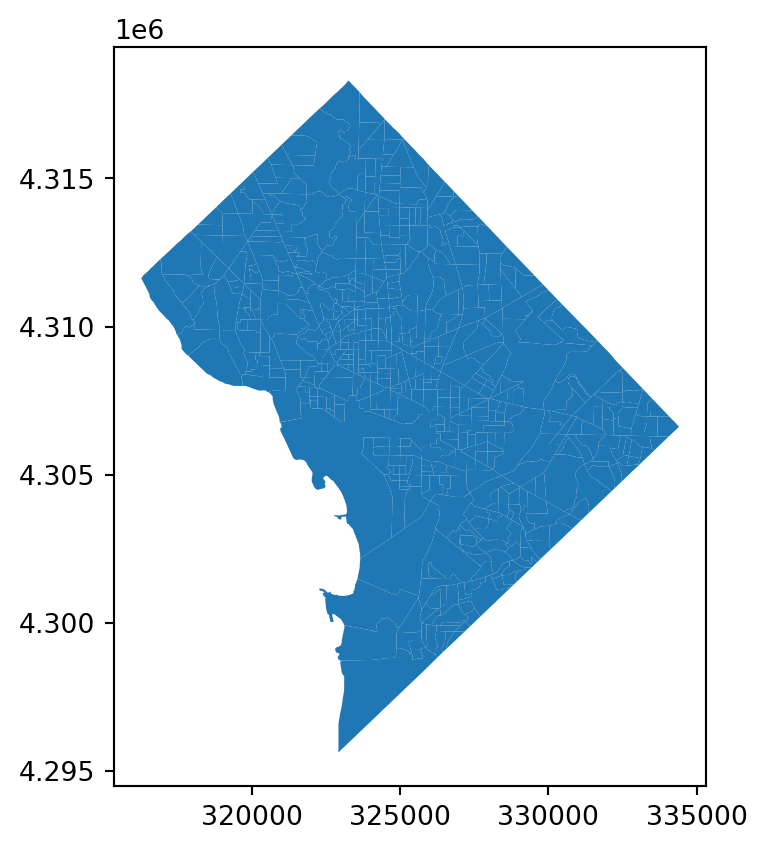

In [4]:
dc = gio.get_acs(datasets, state_fips="11", years=2021)
dc = dc.to_crs(dc.estimate_utm_crs())
dc = dc.set_index("geoid")
dc.plot()

In [5]:
g_rook = Graph.build_contiguity(dc)
g_rook.n

571

In [6]:
dc.shape[0]

571

In [7]:
g_rook.adjacency

focal         neighbor    
110010001011  110010001021    1
              110010001022    1
              110010001023    1
              110010041003    1
              110010055032    1
                             ..
110019800001  110010108002    1
              110010108003    1
              110010108004    1
              110010108005    1
              110010110021    1
Name: weight, Length: 2948, dtype: int64

In [8]:
g_rook.adjacency.reset_index()

,focal,neighbor,weight
0,110010001011,110010001021,1
1,110010001011,110010001022,1
2,110010001011,110010001023,1
3,110010001011,110010041003,1
4,110010001011,110010055032,1
...,...,...,...
2943,110019800001,110010108002,1
2944,110019800001,110010108003,1
2945,110019800001,110010108004,1
2946,110019800001,110010108005,1


In [9]:
g_rook["110019800001"]

neighbor
110010001023    1
110010047021    1
110010056022    1
110010056023    1
110010058011    1
110010058022    1
110010058023    1
110010058024    1
110010059002    1
110010065001    1
110010065002    1
110010066001    1
110010073013    1
110010082002    1
110010082004    1
110010083012    1
110010101001    1
110010101003    1
110010102021    1
110010102023    1
110010102025    1
110010105001    1
110010105004    1
110010106031    1
110010107001    1
110010108002    1
110010108003    1
110010108004    1
110010108005    1
110010110021    1
Name: weight, dtype: int64

In [10]:
g_rook.adjacency.loc["110019800001"]

neighbor
110010001023    1
110010047021    1
110010056022    1
110010056023    1
110010058011    1
110010058022    1
110010058023    1
110010058024    1
110010059002    1
110010065001    1
110010065002    1
110010066001    1
110010073013    1
110010082002    1
110010082004    1
110010083012    1
110010101001    1
110010101003    1
110010102021    1
110010102023    1
110010102025    1
110010105001    1
110010105004    1
110010106031    1
110010107001    1
110010108002    1
110010108003    1
110010108004    1
110010108005    1
110010110021    1
Name: weight, dtype: int64

In [11]:
g_rook.neighbors["110019800001"]

('110010001023',
 '110010047021',
 '110010056022',
 '110010056023',
 '110010058011',
 '110010058022',
 '110010058023',
 '110010058024',
 '110010059002',
 '110010065001',
 '110010065002',
 '110010066001',
 '110010073013',
 '110010082002',
 '110010082004',
 '110010083012',
 '110010101001',
 '110010101003',
 '110010102021',
 '110010102023',
 '110010102025',
 '110010105001',
 '110010105004',
 '110010106031',
 '110010107001',
 '110010108002',
 '110010108003',
 '110010108004',
 '110010108005',
 '110010110021')

In [12]:
g_rook.weights["110019800001"]

(1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1)

In [13]:
g_rook.cardinalities

focal
110010001011     5
110010001021     8
110010001022     5
110010001023     8
110010002011     3
                ..
110010110022     5
110010111001     4
110010111002     5
110010111003    14
110019800001    30
Name: cardinalities, Length: 571, dtype: int64

In [14]:
g_rook.cardinalities.describe()

count    571.000000
mean       5.162872
std        1.919363
min        2.000000
25%        4.000000
50%        5.000000
75%        6.000000
max       30.000000
Name: cardinalities, dtype: float64

<Axes: >

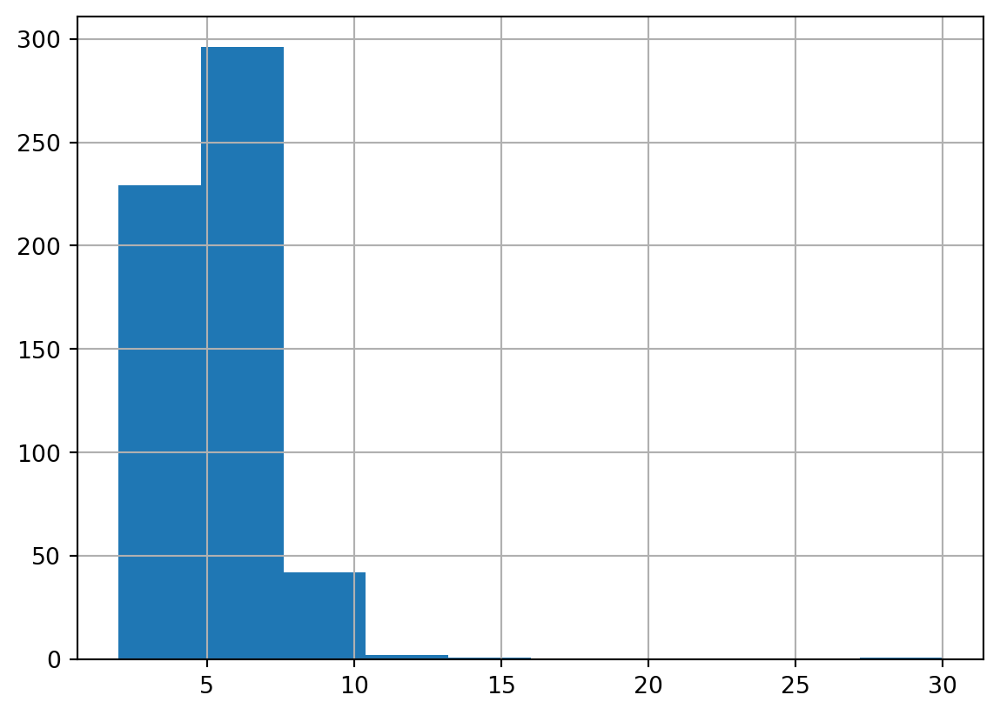

In [15]:
g_rook.cardinalities.hist()

In [16]:
g_rook.pct_nonzero

0.9041807625421343

In [17]:
(g_rook.n_edges / g_rook.n_nodes**2) * 100

0.9041807625421342

In [18]:
g_rook.sparse

<Compressed Sparse Row sparse array of dtype 'float64'
	with 2948 stored elements and shape (571, 571)>

In [19]:
g_rook.sparse.todense()

array([[0., 1., 1., ..., 0., 0., 0.],
       [1., 0., 1., ..., 0., 0., 0.],
       [1., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], shape=(571, 571))

In [20]:
g_rook.unique_ids

Index(['110010001011', '110010001021', '110010001022', '110010001023',
       '110010002011', '110010002012', '110010002021', '110010002022',
       '110010002023', '110010002024',
       ...
       '110010109002', '110010110011', '110010110012', '110010110013',
       '110010110021', '110010110022', '110010111001', '110010111002',
       '110010111003', '110019800001'],
      dtype='object', name='focal', length=571)

In [21]:
g_rook.unique_ids.equals(dc.index)

True

In [22]:
g_rook.sparse.todense().sum(axis=1)[:20].astype(int)

array([5, 8, 5, 8, 3, 6, 6, 6, 4, 6, 5, 3, 9, 6, 6, 7, 8, 3, 6, 7])

In [23]:
g_rook.cardinalities.values[:20]

array([5, 8, 5, 8, 3, 6, 6, 6, 4, 6, 5, 3, 9, 6, 6, 7, 8, 3, 6, 7])

(np.float64(316168.7752046084),
 np.float64(334887.8653454204),
 np.float64(4296336.275195858),
 np.float64(4318383.002576605))

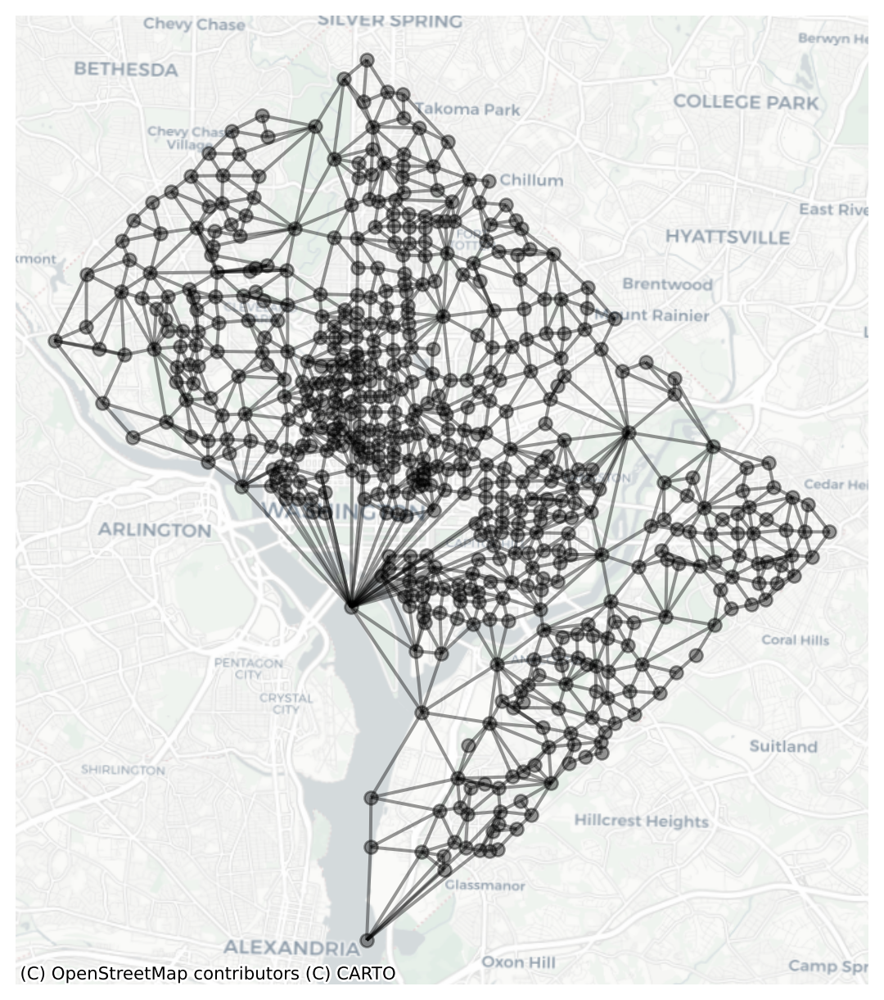

In [24]:
ax = g_rook.plot(dc, node_kws=dict(alpha=0.4), edge_kws=dict(alpha=0.4), figsize=(7, 8))
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=dc.crs)
ax.axis("off")

In [25]:
m = dc.explore(tiles="CartoDB Positron", tooltip=["geoid"])
g_rook.explore(
    dc,
    m=m,
)

In [26]:
cap = gpd.tools.geocode("the national mall, washington d.c.").to_crs(dc.crs)

In [27]:
cap

,geometry,address
0,POINT (324559.841 4306818.589),"U.S. National Archives, 700, Pennsylvania Aven..."


In [28]:
cap.explore(tiles="CartoDB Positron", marker_kwds=dict(radius=20), zoom_start=15)

In [29]:
mall = gpd.overlay(cap, dc.reset_index())

In [30]:
mall

,address,geoid,n_total_housing_units,n_vacant_housing_units,n_occupied_housing_units,n_owner_occupied_housing_units,n_renter_occupied_housing_units,n_housing_units_multiunit_structures_denom,n_housing_units_multiunit_structures,n_total_housing_units_sample,...,p_hispanic_persons,p_native_persons,p_asian_persons,p_hawaiian_persons,p_asian_indian_persons,p_edu_hs_less,p_edu_college_greater,p_veterans,year,geometry
0,"U.S. National Archives, 700, Pennsylvania Aven...",110019800001,5.0,0.0,5.0,0.0,5.0,5.0,5.0,5.0,...,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0,2021,POINT (324559.841 4306818.589)


In [31]:
mall_id = mall.geoid.tolist()[0]

In [32]:
mall_id

'110019800001'

In [33]:
m = dc.loc[[mall_id]].explore(color="red", tooltip=None, tiles="CartoDB Positron")
dc.loc[g_rook[mall_id].index].explore(m=m, tooltip=None)

In [34]:
m = dc.explore(tiles="CartoDB Positron", tooltip=["geoid"])
g_rook.explore(
    dc,
    m=m,
    focal=["110019800001", "110010020012"],
    edge_kws=dict(color="red"),
    node_kws=dict(style_kwds=dict(radius=4, color="yellow")),
)

In [35]:
nxg = g_rook.to_networkx()

<Axes: >

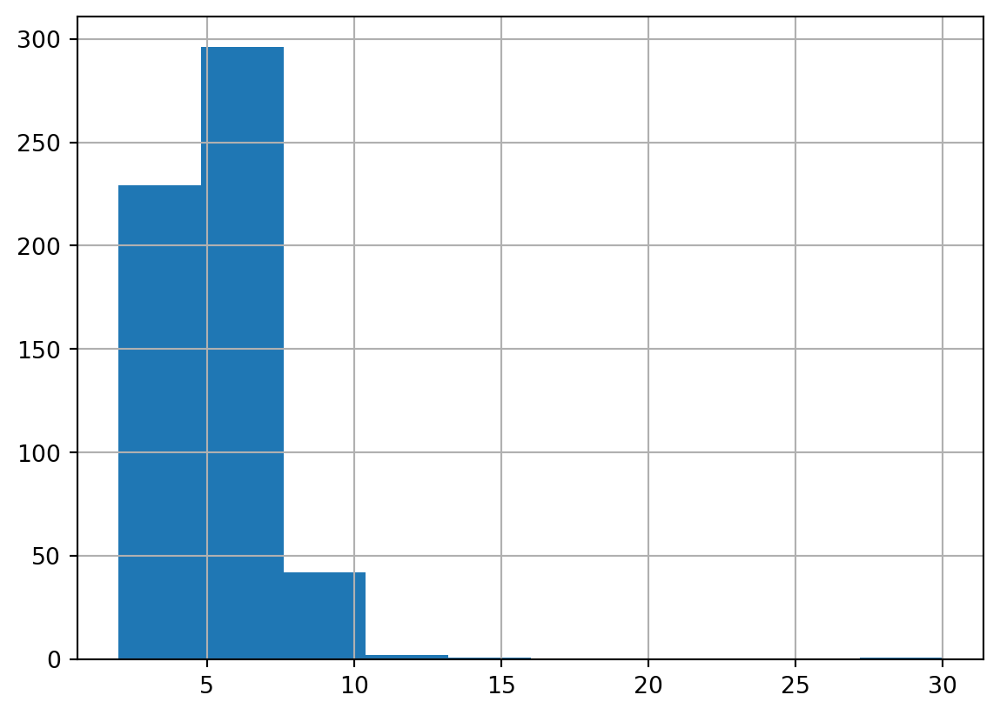

In [36]:
pd.Series([i[1] for i in nxg.degree()]).hist()

In [37]:
g_queen = Graph.build_contiguity(dc, rook=False)

In [38]:
g_queen.pct_nonzero

1.1096763903926192

In [39]:
g_rook.pct_nonzero

0.9041807625421343

<Axes: ylabel='Frequency'>

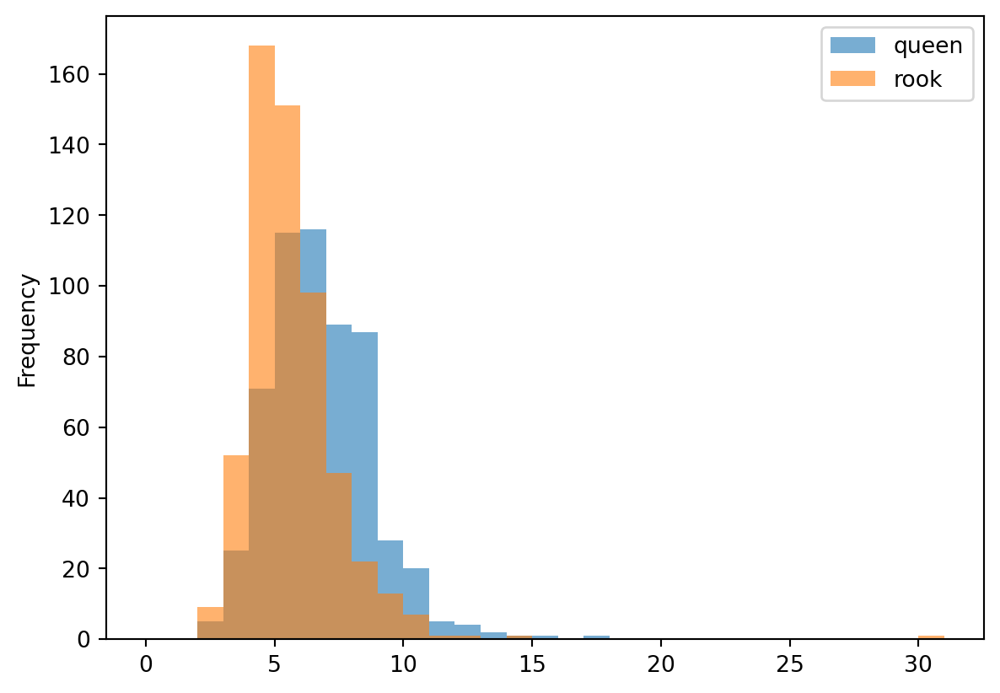

In [40]:
g_queen.cardinalities.rename("queen").plot(
    kind="hist", legend=True, alpha=0.6, bins=range(32)
)
g_rook.cardinalities.rename("rook").plot(
    kind="hist", legend=True, alpha=0.6, bins=range(32)
)

<Axes: ylabel='Density'>

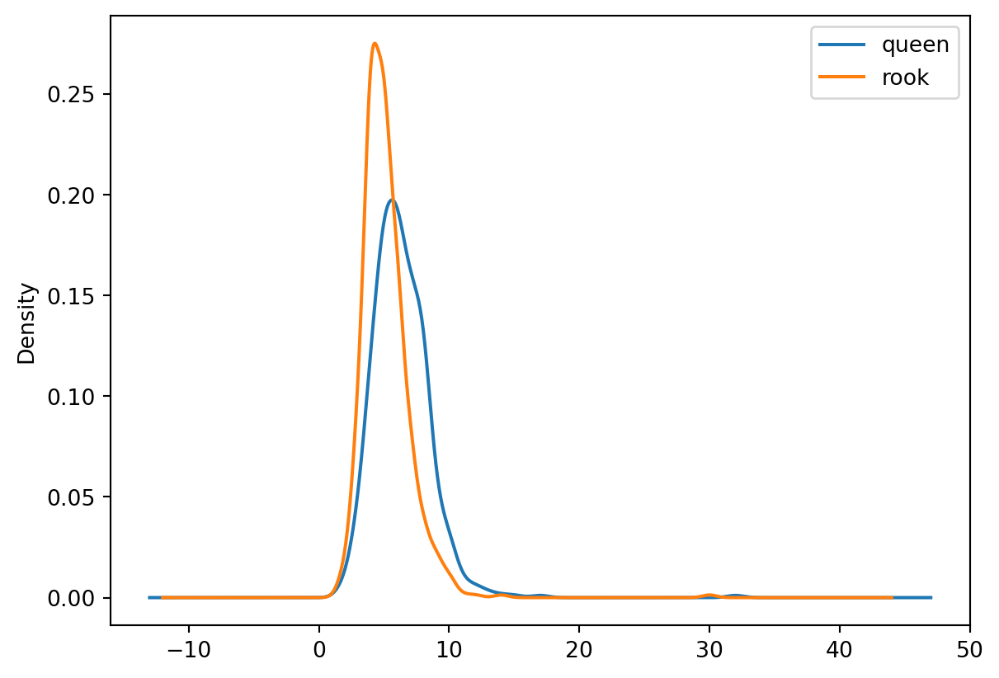

In [41]:
g_queen.cardinalities.rename("queen").plot(kind="density", legend=True)
g_rook.cardinalities.rename("rook").plot(kind="density", legend=True)

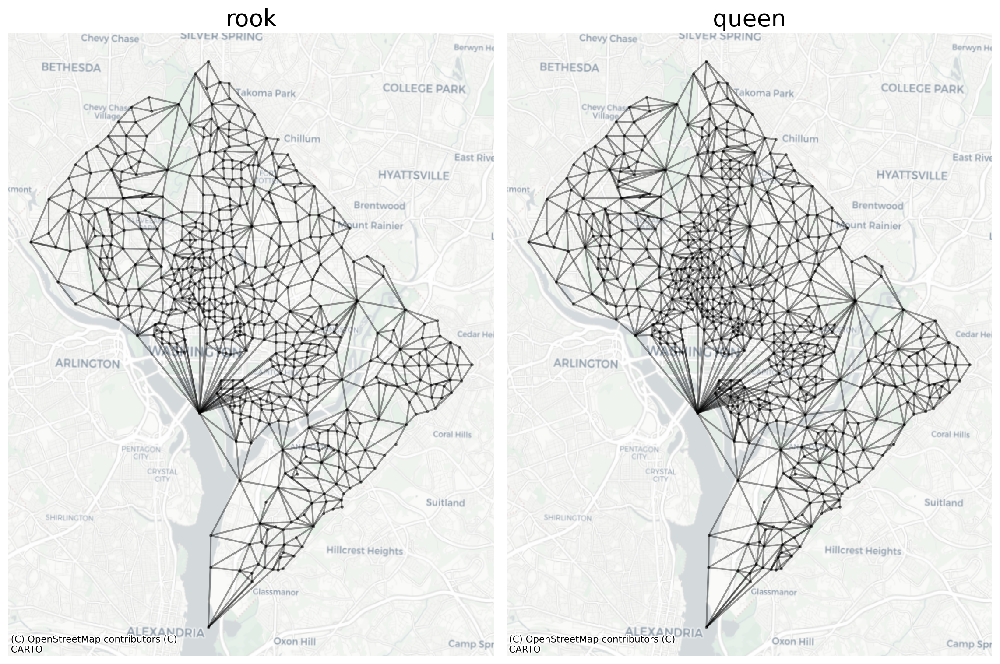

In [42]:
f, ax = plt.subplots(1, 2, figsize=(12, 8))
ax = ax.flatten()

g_rook.plot(
    dc, ax=ax[0], node_kws=dict(alpha=0.4, s=3), edge_kws=dict(alpha=0.4)
).set_title("rook", fontsize=20)

g_queen.plot(
    dc, ax=ax[1], node_kws=dict(alpha=0.4, s=3), edge_kws=dict(alpha=0.4)
).set_title("queen", fontsize=20)

for ax in ax:
    ax.axis("off")
    ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=dc.crs)
plt.tight_layout()

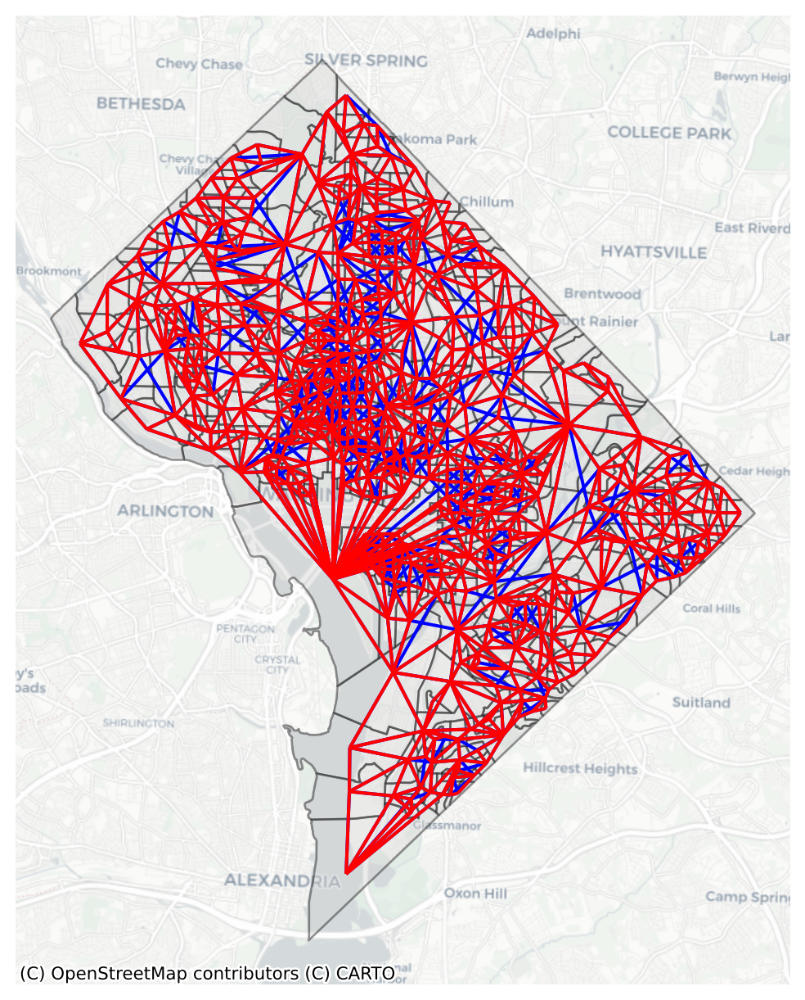

In [43]:
ax = dc.plot(alpha=0.4, color="lightgrey", figsize=(7, 8), edgecolor="black")
ax = g_queen.plot(dc, ax=ax, nodes=False, edge_kws=dict(color="blue"), figsize=(7, 8))

g_rook.plot(dc, ax=ax, nodes=False, edge_kws=dict(color="red"))

ax.axis("off")
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=dc.crs)

In [44]:
bishop = g_queen.difference(g_rook)

In [45]:
m = dc.explore(
    tooltip=None,
    style_kwds=dict(color="black", fill=False),
    tiles="CartoDB Positron",
)
bishop.explore(
    dc, m=m, nodes=True, edge_kws=dict(color="purple", style_kwds=dict(weight=5))
)

In [46]:
dc.crs

<Projected CRS: EPSG:32618>
Name: WGS 84 / UTM zone 18N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 78°W and 72°W, northern hemisphere between equator and 84°N, onshore and offshore. Bahamas. Canada - Nunavut; Ontario; Quebec. Colombia. Cuba. Ecuador. Greenland. Haiti. Jamaica. Panama. Turks and Caicos Islands. United States (USA). Venezuela.
- bounds: (-78.0, 0.0, -72.0, 84.0)
Coordinate Operation:
- name: UTM zone 18N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

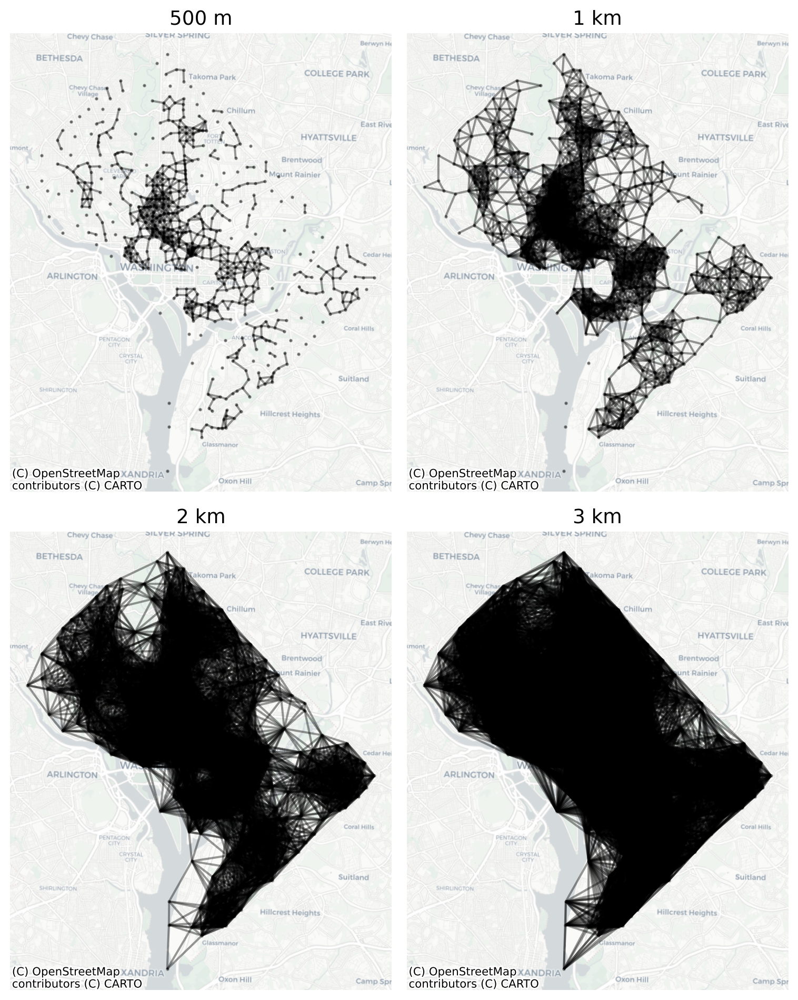

In [47]:
#| label: fig-increasing-dist-graph
#| fig-cap: '`Graph` with Increasing Distance Band'

g_dist_500 = Graph.build_distance_band(dc.centroid, threshold=500)
g_dist_1000 = Graph.build_distance_band(dc.centroid, threshold=1000)
g_dist_2000 = Graph.build_distance_band(dc.centroid, threshold=2000)
g_dist_3000 = Graph.build_distance_band(dc.centroid, threshold=3000)

f, ax = plt.subplots(2, 2, figsize=(8, 10))
gs = [g_dist_500, g_dist_1000, g_dist_2000, g_dist_3000]
labels = ["500 m", "1 km", "2 km", "3 km"]
ax = ax.flatten()

for i in range(len(ax)):
    gs[i].plot(
        dc, ax=ax[i], node_kws=dict(alpha=0.4, s=2), edge_kws=dict(alpha=0.4)
    ).set_title(labels[i], fontsize=14)

    ax[i].axis("off")
    ctx.add_basemap(ax[i], source=ctx.providers.CartoDB.Positron, crs=dc.crs)
plt.tight_layout()

<Axes: >

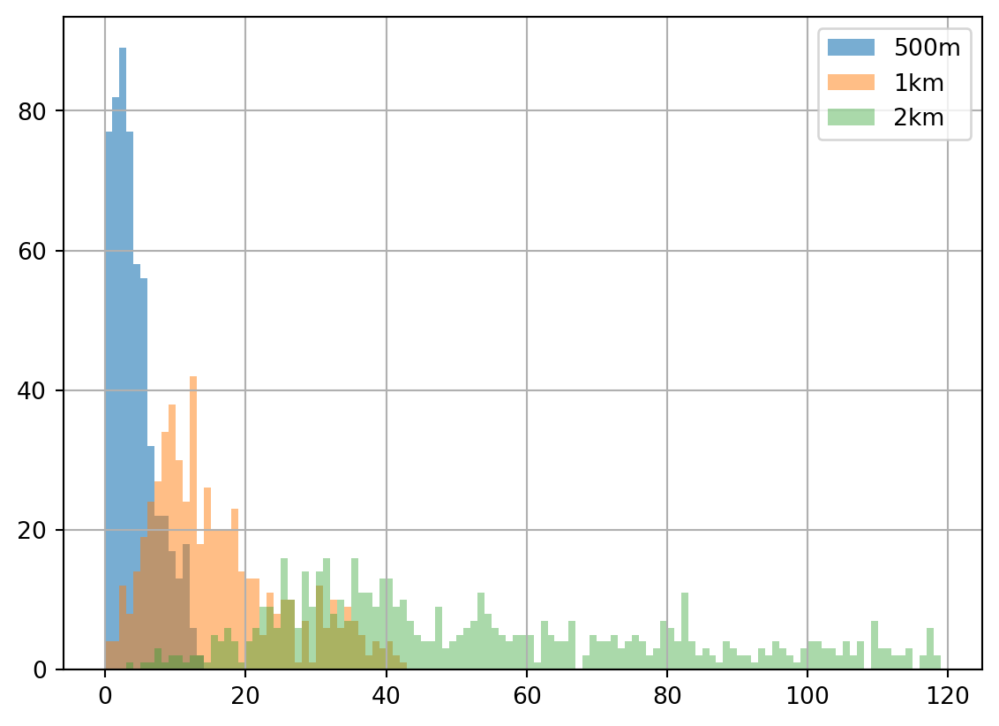

In [48]:
bins = range(0, 120)
g_dist_500.cardinalities.rename("500m").hist(alpha=0.6, legend=True, bins=bins)
g_dist_1000.cardinalities.rename("1km").hist(alpha=0.5, legend=True, bins=bins)
g_dist_2000.cardinalities.rename("2km").hist(alpha=0.4, legend=True, bins=bins)

In [49]:
g_dist_1000.n_components

5

In [50]:
g_dist_1000.isolates

Index(['110010073011', '110010073012', '110010073013', '110010109002'], dtype='object', name='focal')

In [51]:
g_dist_1000.component_labels

focal
110010001011    0
110010001021    0
110010001022    0
110010001023    0
110010002011    0
               ..
110010110022    0
110010111001    0
110010111002    0
110010111003    0
110019800001    0
Name: component labels, Length: 571, dtype: int32

In [52]:
nxg_dist = g_dist_1000.to_networkx()

<Axes: >

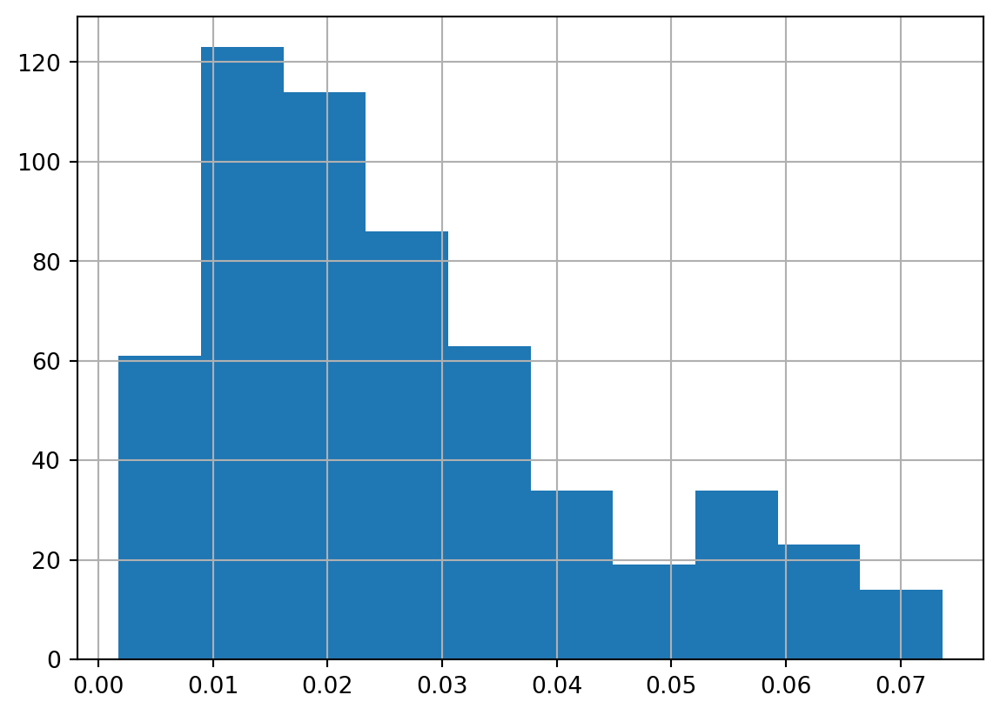

In [53]:
pd.Series(nx.degree_centrality(nxg_dist)).hist()

In [54]:
# closeness centrality
close = (
    pd.Series(nx.closeness_centrality(nxg_dist)).sort_values(ascending=False).index[0]
)
# betweenness centrality
between = (
    pd.Series(nx.betweenness_centrality(nxg_dist)).sort_values(ascending=False).index[0]
)
# degree centrality
degree = pd.Series(nx.degree_centrality(nxg_dist)).sort_values(ascending=False).index[0]

# plot the most "central" node according to each metric
focal_kws = dict(marker_kwds=dict(radius=10), style_kwds=dict(fillOpacity=1))
centralities = zip(["red", "yellow", "blue"], [close, between, degree])

m = g_dist_1000.explore(
    dc,
    color="gray",
    tiles="CartoDB Darkmatter",
    edge_kws=dict(style_kwds=dict(opacity=0.4)),
)

for color, measure in centralities:
    m = g_dist_1000.explore(
        dc,
        focal=measure,
        color=color,
        focal_kws=focal_kws,
        m=m,
    )
m

In [55]:
g_knn5 = Graph.build_knn(dc.centroid, k=5)
g_knn10 = Graph.build_knn(dc.centroid, k=10)

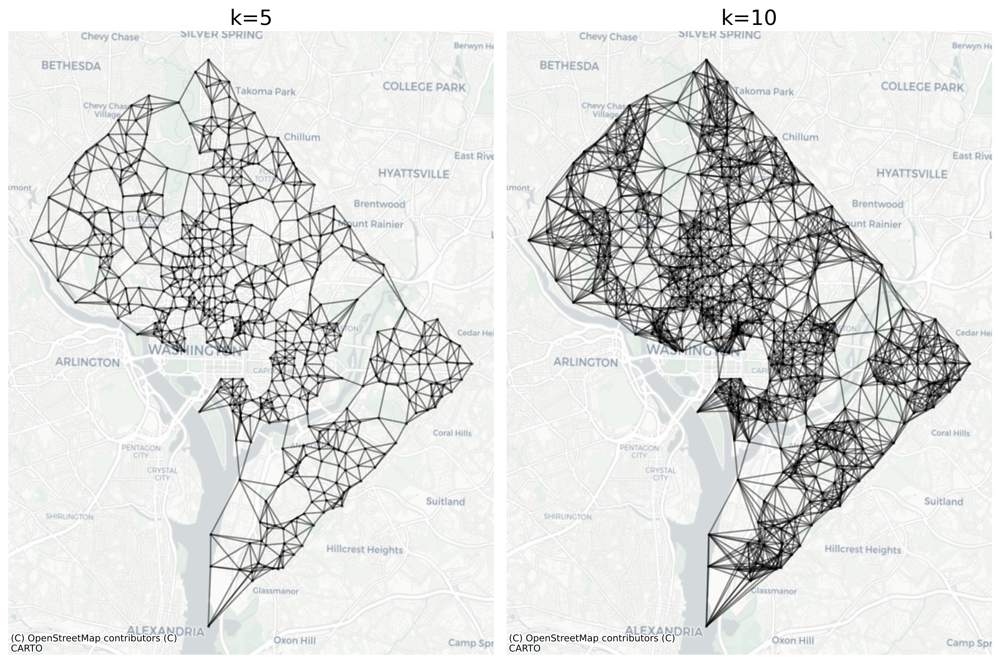

In [56]:
f, ax = plt.subplots(1, 2, figsize=(12, 8))
ax = ax.flatten()

g_knn5.plot(
    dc, ax=ax[0], node_kws=dict(alpha=0.4, s=3), edge_kws=dict(alpha=0.4)
).set_title("k=5", fontsize=18)

g_knn10.plot(
    dc, ax=ax[1], node_kws=dict(alpha=0.4, s=3), edge_kws=dict(alpha=0.4)
).set_title("k=10", fontsize=18)

for ax in ax:
    ax.axis("off")
    ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=dc.crs)
plt.tight_layout()

In [57]:
g_dist_1000.asymmetry()

Series([], Name: neighbor, dtype: object)

In [58]:
g_queen.asymmetry()

Series([], Name: neighbor, dtype: object)

In [59]:
g_knn10.asymmetry().head(10)

focal
110010001011    110010001021
110010001011    110010002022
110010001011    110010002023
110010001011    110010055012
110010001011    110010055023
110010001011    110010056011
110010001021    110010001011
110010001021    110010002012
110010001021    110010005013
110010001021    110010041002
Name: neighbor, dtype: object

In [60]:
g_knn10.asymmetry().groupby("focal").first().shape[0]

558

In [61]:
g_knn10.pct_nonzero

1.7513134851138354

In [62]:
g_knn10.asymmetry().groupby("focal").first().shape[0] / g_knn10.n

0.9772329246935202

In [63]:
symmetric = g_knn10.unique_ids[
    ~g_knn10.unique_ids.isin(g_knn10.asymmetry().index.values)
]

In [64]:
symmetric

Index(['110010013012', '110010013042', '110010024002', '110010024003',
       '110010030001', '110010043002', '110010044021', '110010052023',
       '110010080012', '110010092011', '110010093021', '110010095081',
       '110010108003'],
      dtype='object', name='focal')

(np.float64(320008.3228898232),
 np.float64(328771.65025115275),
 np.float64(4306210.070095919),
 np.float64(4315149.962498408))

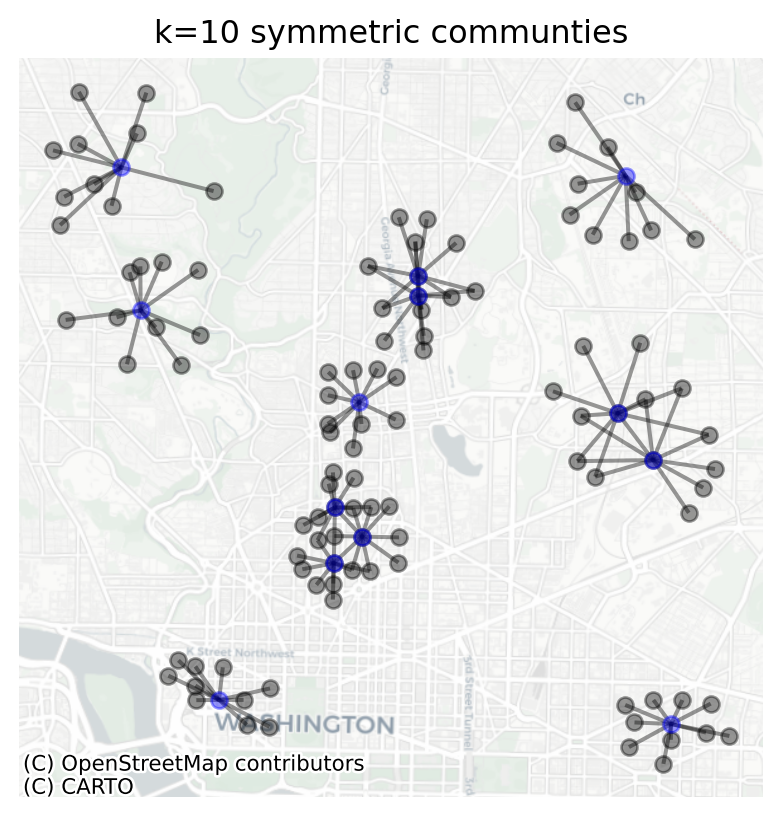

In [65]:
ax = g_knn10.plot(
    dc,
    node_kws=dict(alpha=0.4),
    edge_kws=dict(alpha=0.4),
    focal=symmetric,
    focal_kws=dict(color="blue"),
    figsize=(5, 5),
)
ax.set_title("k=10 symmetric communties")
ctx.add_basemap(ax=ax, source=ctx.providers.CartoDB.Positron, crs=dc.crs)
ax.axis("off")

<Axes: >

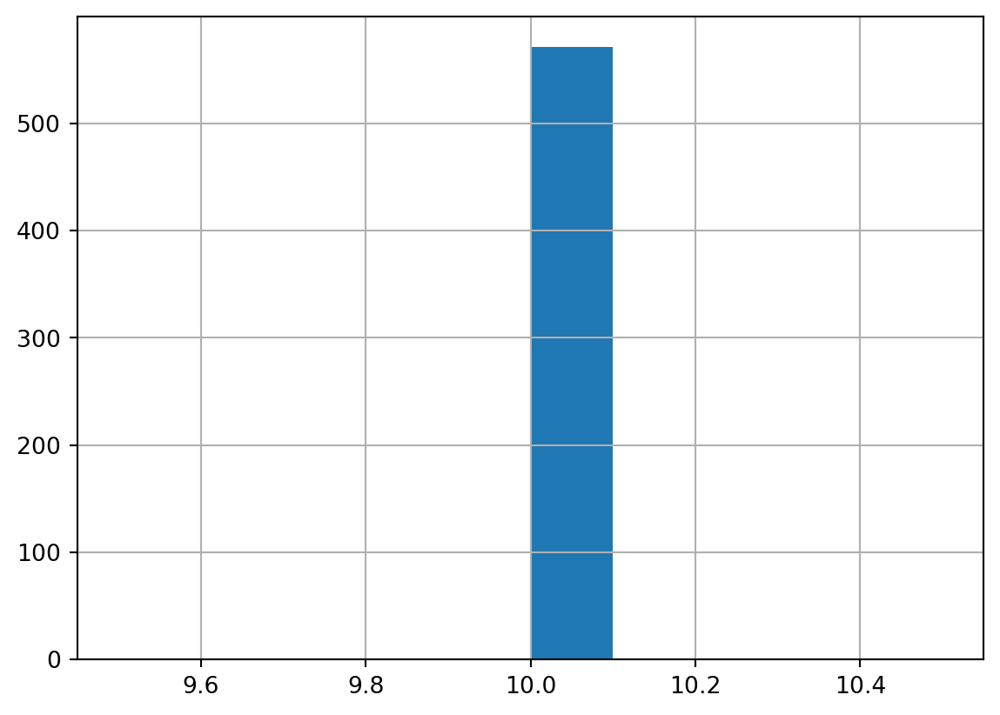

In [66]:
g_knn10.cardinalities.hist()

In [67]:
g_kernel_linear = Graph.build_kernel(dc.centroid, kernel="triangular", bandwidth=1000)
g_kernel_gaussian = Graph.build_kernel(dc.centroid, kernel="gaussian", bandwidth=1000)

In [68]:
g_kernel_linear.adjacency.head(5)

focal         neighbor    
110010001011  110010001021    0.153963
              110010001022    0.470889
              110010041001    0.070221
              110010041003    0.387908
              110010055011    0.449957
Name: weight, dtype: float64

In [69]:
g_kernel_gaussian.adjacency.head(5)

focal         neighbor    
110010001011  110010001021    0.188200
              110010001022    0.209865
              110010001023    0.156752
              110010002011    0.091723
              110010002012    0.119689
Name: weight, dtype: float64

In [70]:
g_kernel_linear.explore(
    dc,
    # pick a random node in the graph to visualize
    focal=dc.reset_index().geoid.sample(),
    edge_kws=dict(
        column="weight",
        style_kwds=dict(weight=5),
    ),
    tiles="CartoDB Darkmatter",
)

In [71]:
g_rook.adjacency.head(10)

focal         neighbor    
110010001011  110010001021    1
              110010001022    1
              110010001023    1
              110010041003    1
              110010055032    1
110010001021  110010001011    1
              110010001022    1
              110010002021    1
              110010002022    1
              110010004002    1
Name: weight, dtype: int64

In [72]:
?g_rook.transform

In [73]:
g_rook.transform("r").adjacency.head(10)

focal         neighbor    
110010001011  110010001021    0.200
              110010001022    0.200
              110010001023    0.200
              110010041003    0.200
              110010055032    0.200
110010001021  110010001011    0.125
              110010001022    0.125
              110010002021    0.125
              110010002022    0.125
              110010004002    0.125
Name: weight, dtype: float64

In [74]:
g_kernel_linear.adjacency

focal         neighbor    
110010001011  110010001021    0.153963
              110010001022    0.470889
              110010041001    0.070221
              110010041003    0.387908
              110010055011    0.449957
                                ...   
110010111002  110010094003    0.246455
              110010111001    0.189411
110010111003  110010089031    0.013633
110019800001  110010102025    0.276093
              110010102026    0.031202
Name: weight, Length: 8732, dtype: float64

In [75]:
g_kernel_linear.transform("r").adjacency

focal         neighbor    
110010001011  110010001021    0.032531
              110010001022    0.099494
              110010041001    0.014837
              110010041003    0.081961
              110010055011    0.095071
                                ...   
110010111002  110010094003    0.297544
              110010111001    0.228675
110010111003  110010089031    1.000000
110019800001  110010102025    0.898464
              110010102026    0.101536
Name: weight, Length: 8732, dtype: float64

In [76]:
g_kernel_linear.transform("r").adjacency.groupby(level=0).sum()

focal
110010001011    1.0
110010001021    1.0
110010001022    1.0
110010001023    1.0
110010002011    1.0
               ... 
110010110022    1.0
110010111001    1.0
110010111002    1.0
110010111003    1.0
110019800001    1.0
Name: weight, Length: 571, dtype: float64

In [77]:
g_kernel_linear.transform("d").adjacency.groupby(level=0).sum().sum()

np.float64(0.9999999999999999)

In [78]:
dc_flows = pd.read_csv(
    "https://lehd.ces.census.gov/data/lodes/LODES7/dc/od/dc_od_main_JT00_2019.csv.gz"
)

In [79]:
# the block-level data is large, so save to disk before reading in
dc_blks = datasets.blocks_2010(states="11")

In [80]:
dc_flows[["w_geocode", "h_geocode"]] = dc_flows[["w_geocode", "h_geocode"]].astype(str)
dc_flows["S000"] = dc_flows["S000"].astype(float)

dc_blks = dc_blks[dc_blks.geoid.isin(dc_flows.w_geocode.unique())]
ids = dc_blks.geoid.values

dc_flows_sparse = (
    dc_flows.set_index(["w_geocode", "h_geocode"])["S000"]
    .astype("Sparse[float]")
    .reindex(ids, level=0)
    .reindex(ids, level=1)
    .sparse.to_coo(sort_labels=True)[0]
)

g_flow = Graph.from_sparse(dc_flows_sparse, ids=ids)

<Axes: >

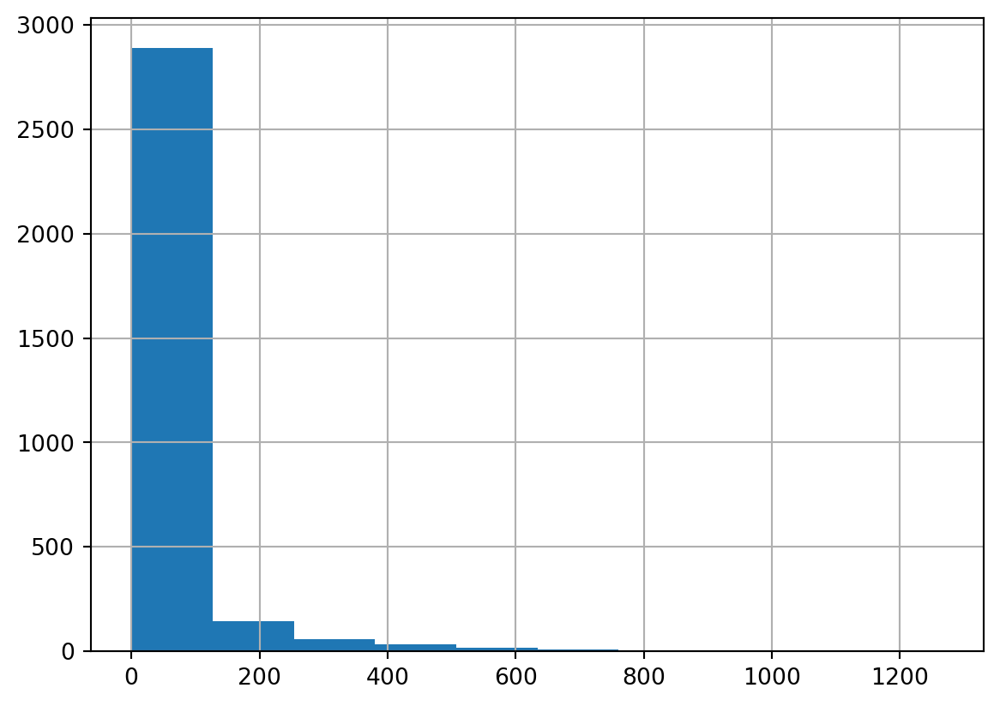

In [81]:
g_flow.cardinalities.hist()

In [82]:
g_flow.pct_nonzero

1.28891109652

In [83]:
g_flow.adjacency.reset_index().describe()

,weight
count,128950.000000
mean,1.268313
std,0.960348
min,0.000000
25%,1.000000
50%,1.000000
75%,1.000000
max,144.000000


<Axes: >

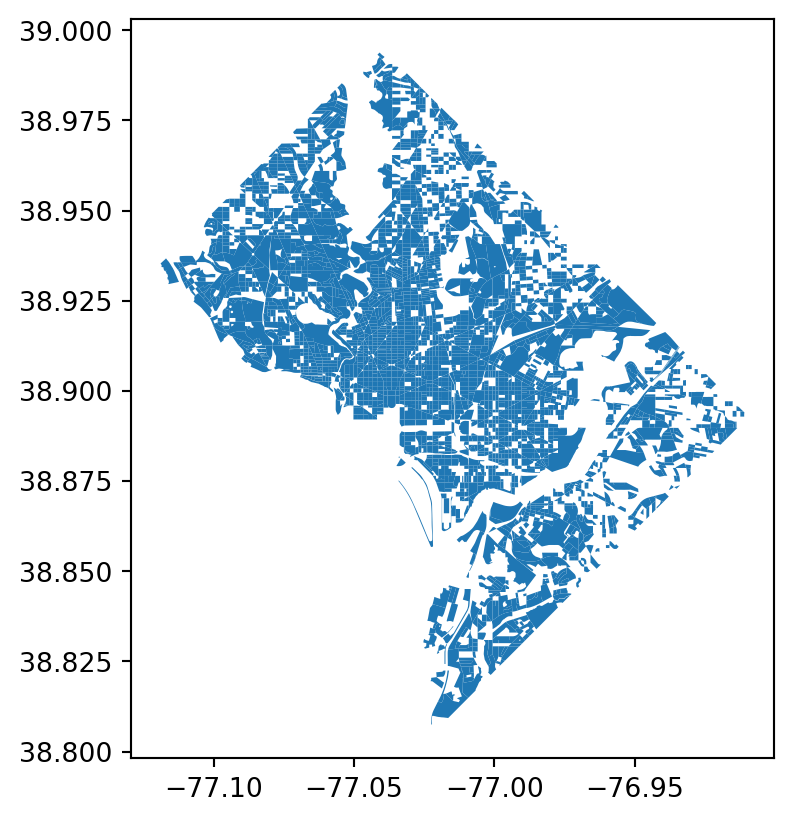

In [84]:
dc_blks.plot()

In [85]:
g_flow.adjacency

focal            neighbor       
110010011004003  110010106001001    1.0
110010014023001  110010050021002    1.0
                 110010021011002    1.0
110010012001008  110010027021000    1.0
110010012004020  110010095051004    1.0
                                   ... 
110010002023010  110010025023004    1.0
                 110010058002004    1.0
                 110010007013001    1.0
                 110010043002005    1.0
110010097001012  110010044001017    1.0
Name: weight, Length: 128950, dtype: float64

In [86]:
g_flow.n

3163

In [87]:
dc_blks.shape[0]

3163

(np.float64(-77.12566018280897),
 np.float64(-76.90141343715167),
 np.float64(38.806294724999994),
 np.float64(39.001803775))

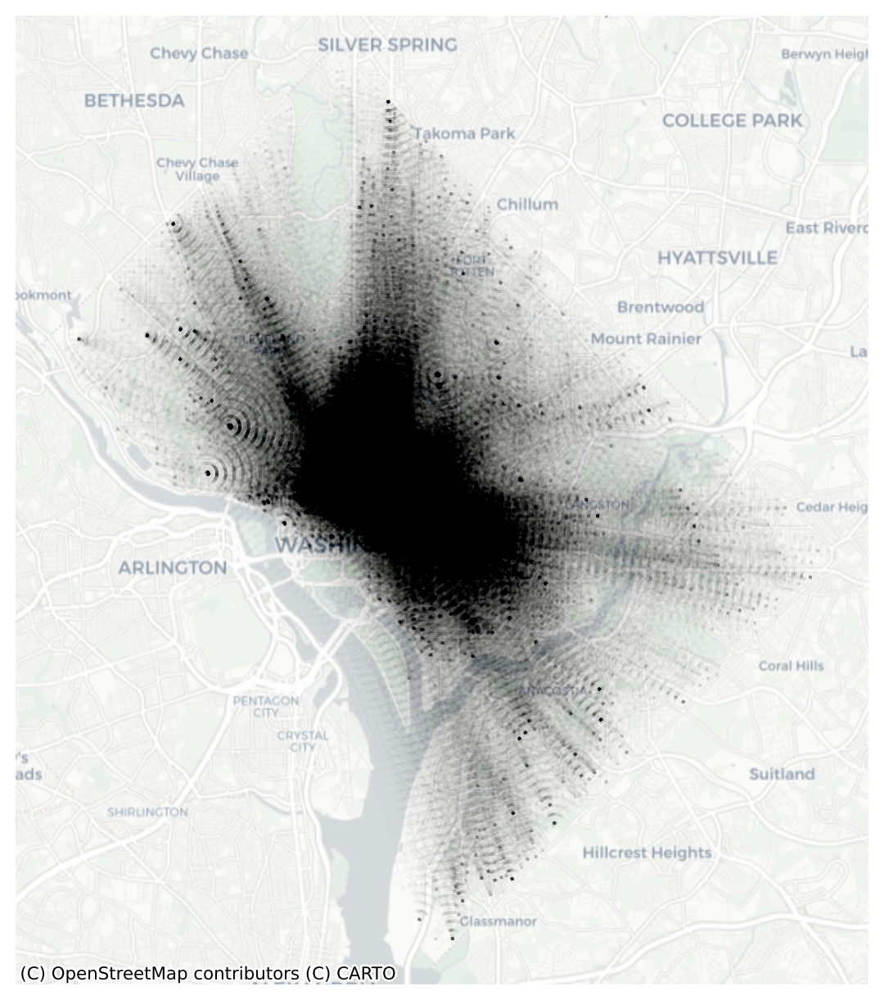

In [88]:
ax = g_flow.plot(
    dc_blks.set_index("geoid"),
    nodes=False,
    edge_kws=dict(alpha=0.004, linestyle="dotted"),
    figsize=(7,8),
)
ctx.add_basemap(ax=ax, source=ctx.providers.CartoDB.Positron, crs=dc_blks.crs)
ax.axis("off")